In [1]:
import generaluse as gu
import resultsmanaging as rm

import pandas as pd
import cv2
import skimage as ski

import imgproc as ip
import matplotlib.pyplot as plt
import numpy as np

%load_ext autoreload
%autoreload 2

In [2]:
folder_name = 'batch03'

dictionary = gu.getImgNamesAndPaths(f"rawdata/{folder_name}")

list_filenames = list(dictionary.keys())
list_filepaths = [*dictionary.values()]

list_data = []
for name, path in zip(list_filenames,list_filepaths):
    data = dict()
    data["Filename"] = name
    data["Filepath"] = path
    list_data.append(data)

dataframe = pd.DataFrame(data=list_data)
dataframe

,Filename,Filepath
0,Experiment-863.jpg,rawdata/batch03/Experiment-863.jpg
1,Experiment-866.jpg,rawdata/batch03/Experiment-866.jpg
2,Experiment-867.jpg,rawdata/batch03/Experiment-867.jpg
3,Experiment-868.jpg,rawdata/batch03/Experiment-868.jpg
4,Experiment-869.jpg,rawdata/batch03/Experiment-869.jpg
5,Experiment-870.jpg,rawdata/batch03/Experiment-870.jpg
6,Experiment-871.jpg,rawdata/batch03/Experiment-871.jpg


In [3]:
list_imgs = gu.getImagesFromPathfile(list_filepaths,cv2.COLOR_BGR2GRAY)

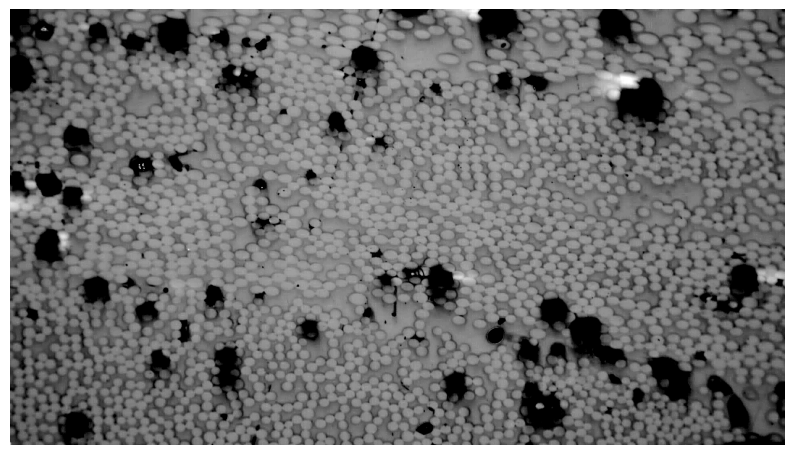

(-0.5, 1919.5, 1079.5, -0.5)

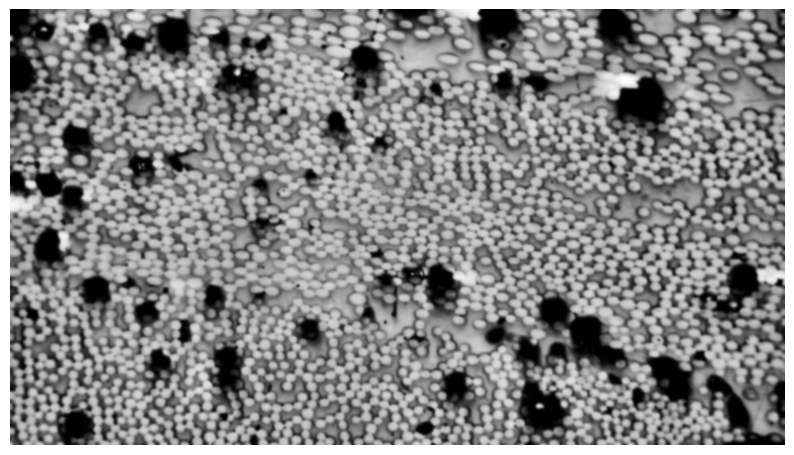

In [4]:
img_selected = list_imgs[0]

fig = plt.figure(figsize=(10, 10))
plt.imshow(img_selected, cmap='gray')
plt.axis('off')
plt.show()

test_1 = cv2.GaussianBlur(img_selected, (7, 7), 0)
clahe = cv2.createCLAHE(clipLimit=2,tileGridSize=(10, 10))
test_2 = cv2.GaussianBlur(clahe.apply(test_1), (11, 11), 0)

fig = plt.figure(figsize=(10, 10))
plt.imshow(test_2, cmap='gray')
plt.axis('off')

In [5]:
list_ts_test_2 = ski.filters.threshold_multiotsu(test_2, classes=5)
print(list_ts_test_2)

[ 43  94 134 172]


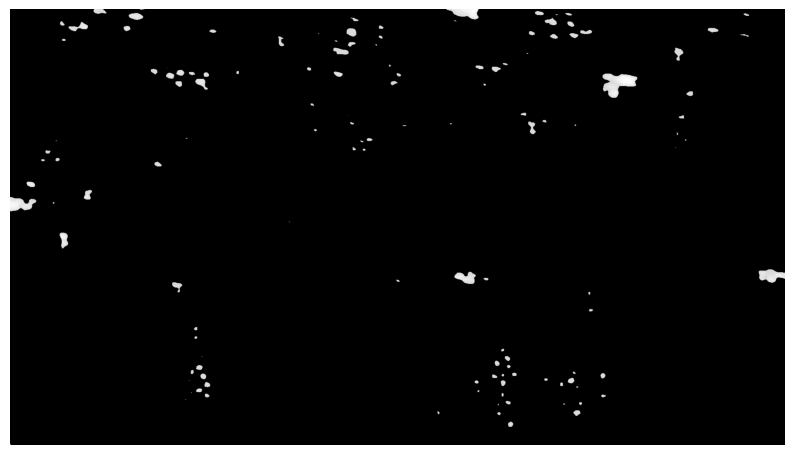

In [6]:
destellos = test_2.copy()

destellos[test_2 <= np.mean([list_ts_test_2[-1],255])] = 0

fig = plt.figure(figsize=(10, 10))
plt.imshow(destellos, cmap='gray')
plt.axis('off')
plt.show()

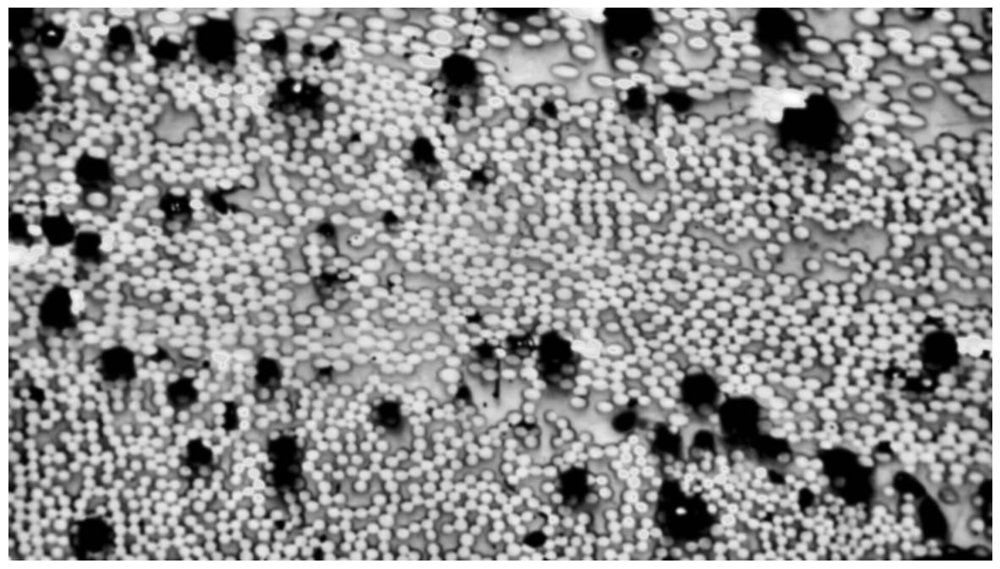

In [7]:
test_2_sindestellos = test_2.copy()
test_2_sindestellos[destellos != 0] = 0.91*test_2_sindestellos[destellos != 0]
test_2_sindestellos = np.uint8(test_2_sindestellos)

fig = plt.figure(figsize=(15, 15))
plt.imshow(test_2_sindestellos, cmap='gray')
plt.axis('off')
plt.show()

#test_2 = test_2_sindestellos.copy()

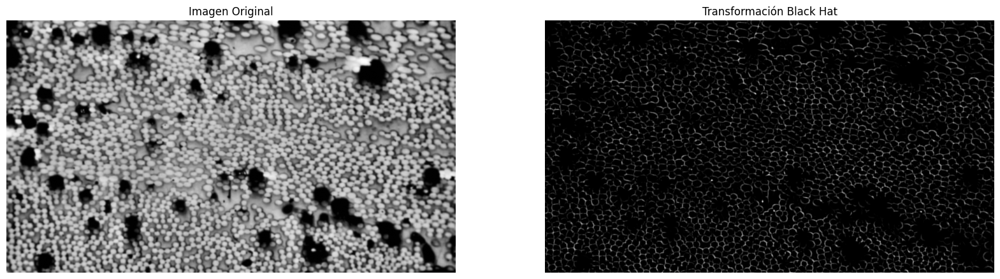

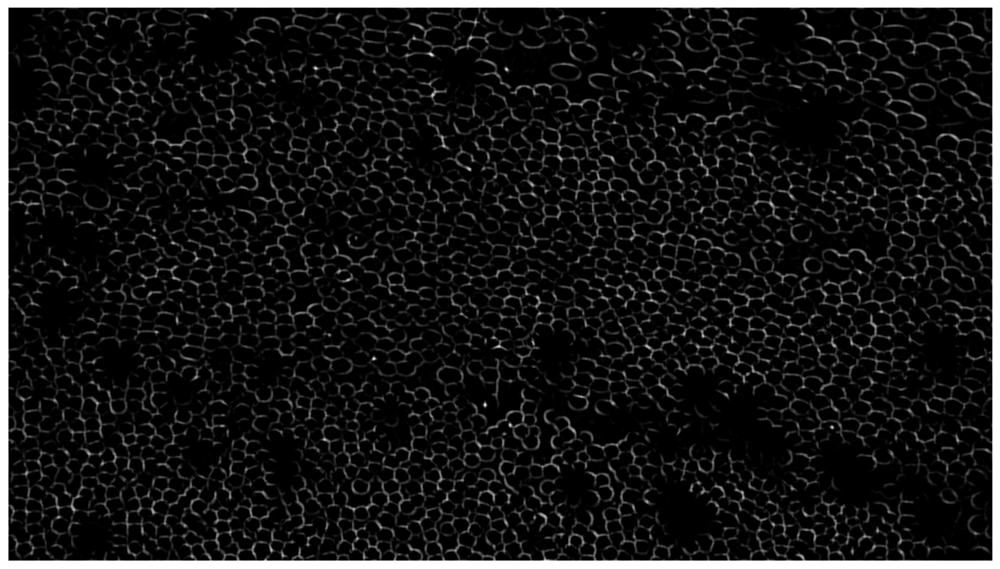

In [8]:
def analyze_black_hat(image, kernel_size=(5,5)):
    """
    Aplica la transformación Black Hat a una imagen
    
    Parámetros:
    - image: imagen en escala de grises
    - kernel_size: tamaño del kernel para la operación morfológica
    
    Retorna:
    - black_hat: imagen resultante de la transformación
    """
    # Crear kernel para operación morfológica
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    
    # Aplicar transformación Black Hat
    black_hat = cv2.morphologyEx(image, cv2.MORPH_BLACKHAT, kernel)
    
    return black_hat


# Aplicar Black Hat a la imagen seleccionada
black_hat_img = analyze_black_hat(test_2, kernel_size=(7, 7)) #(5,5)

# Visualizar resultados
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))

ax1.imshow(test_2, cmap='gray')
ax1.set_title('Imagen Original')
ax1.axis('off')

ax2.imshow(black_hat_img, cmap='gray')
ax2.set_title('Transformación Black Hat')
ax2.axis('off')

fig = plt.figure(figsize=(15, 15))
plt.imshow(black_hat_img, cmap='gray')
plt.axis('off')
plt.show()

plt.show()

In [9]:
list_ts = ski.filters.threshold_multiotsu(black_hat_img, classes=5)
print(list_ts)

[ 4 11 19 29]


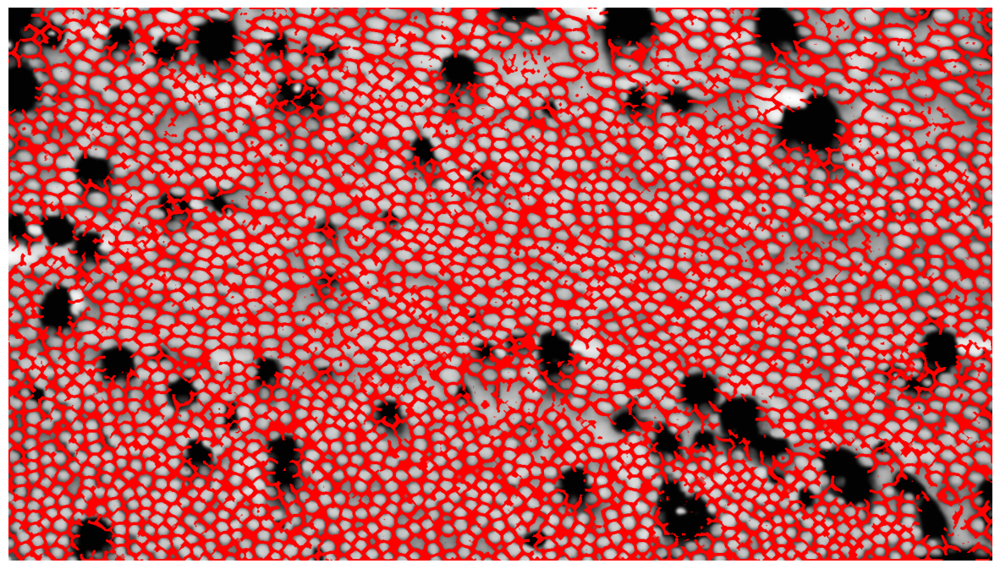

In [10]:
black_hat_mask = black_hat_img

kernel = np.array([[0, 1, 0],
                   [1, 0, 1],
                   [0, 1, 0]], dtype=np.uint8)

black_hat_mask = cv2.morphologyEx(black_hat_mask, cv2.MORPH_CLOSE, kernel,iterations=4)


test_2_rgb = cv2.cvtColor(test_2, cv2.COLOR_GRAY2RGB)
test_2_rgb[black_hat_mask > 0] = [255, 0, 0]  # Color rojo para la máscara

fig = plt.figure(figsize=(15, 15))
plt.imshow(test_2_rgb)
plt.axis('off')
plt.show()

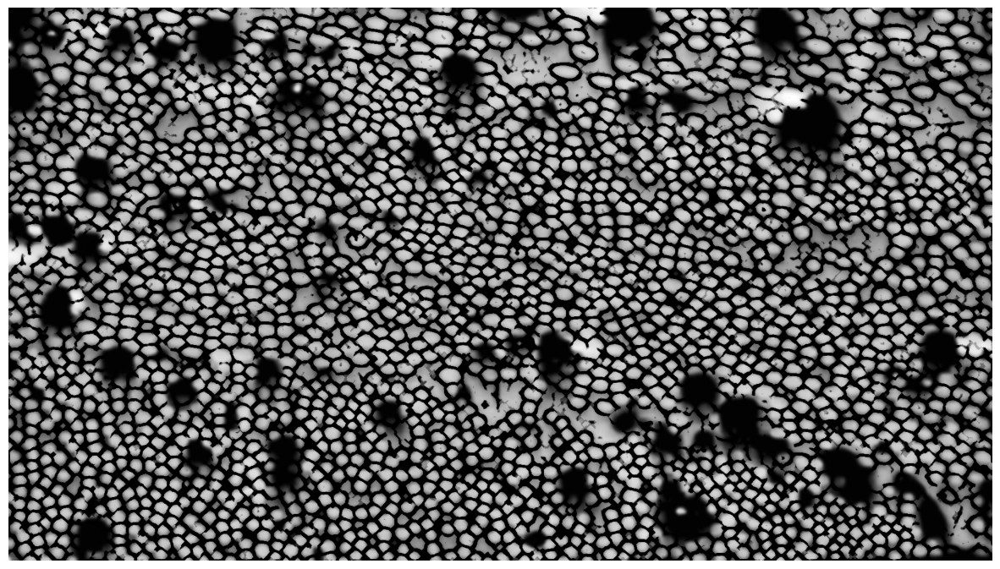

In [11]:
test_3 = np.int16(test_2) - 60*np.int16(black_hat_mask)
test_3[test_3 < 0] = 0
test_3 = np.uint8(test_3)

fig = plt.figure(figsize=(15, 15))
plt.imshow(test_3, cmap='gray')
plt.axis('off')
plt.show()

In [12]:
list_ts_test3 = ski.filters.threshold_multiotsu(test_3, classes=5)
print(list_ts_test3)

[ 33  91 138 175]


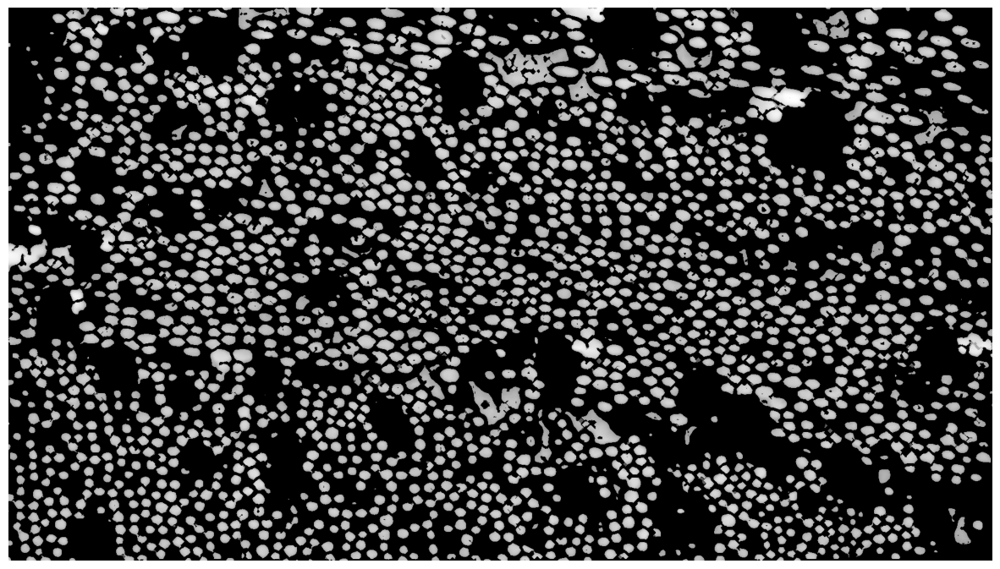

In [13]:
thresh_1 = np.zeros(np.shape(test_3),dtype=np.uint8)

thresh_1[test_3 > np.mean(list_ts_test3[2:])] = 255 #2:

test_4 = test_3.copy()
test_4[~(thresh_1 == 255)] = 0


fig = plt.figure(figsize=(15,15))
plt.imshow(test_4,cmap='gray',vmin=0,vmax=255)
plt.axis('off')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Number of contours: 1993


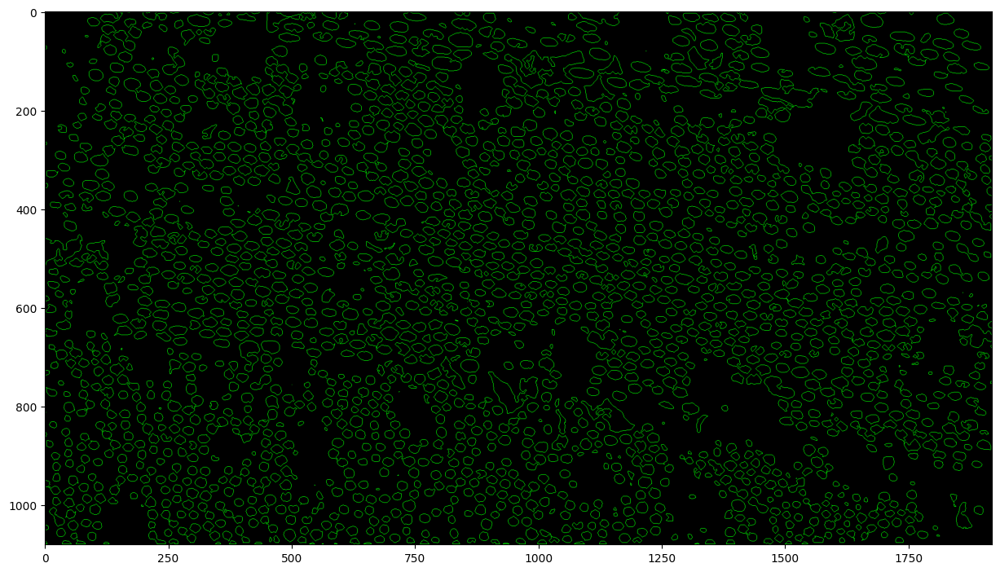

30.123432012042148
17.70261724047006


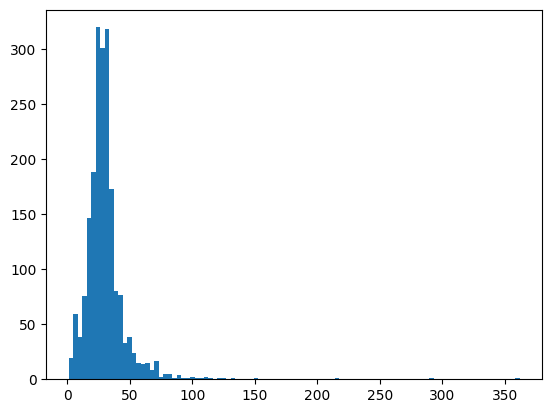

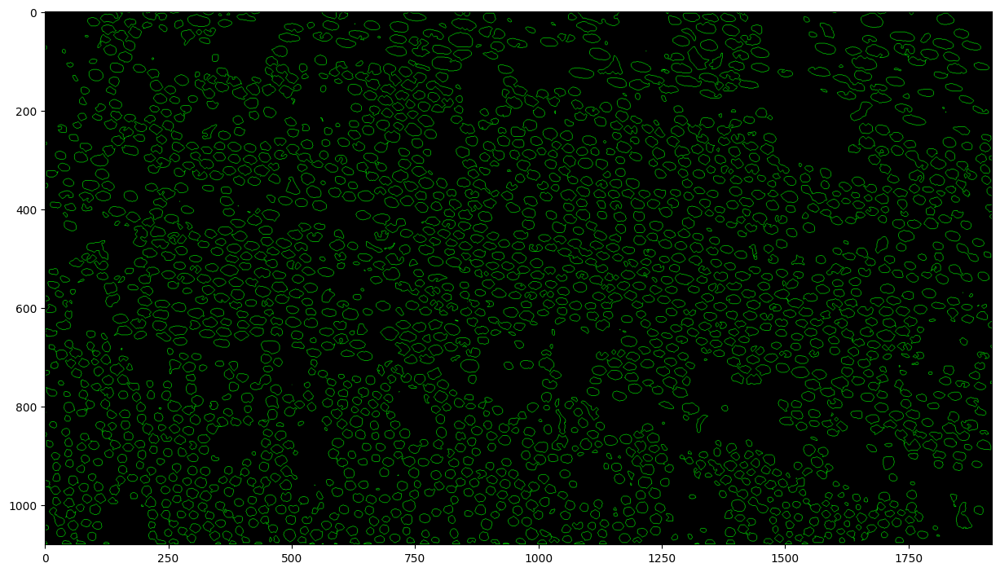

In [40]:
test_5 = test_4.copy()
test_5[test_5 > 0] = 255

contours_fibers, hierarchy_fibers = cv2.findContours(image=test_5, mode=cv2.RETR_EXTERNAL, method=cv2.CHAIN_APPROX_SIMPLE)

print(f"Number of contours: {len(contours_fibers)}")

dim = np.shape(test_5)

img_contornos_2 = cv2.drawContours(np.zeros((dim[0],dim[1],3)), contours_fibers, -1, (0,255,0), 1)
img_contornos_3 = np.uint8(img_contornos_2)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1, 1, 1)
ax.imshow(img_contornos_2,vmin=0,vmax=255)
plt.show()

contours_fibers_lenght = [len(c) for c in contours_fibers]

cfl_mean = np.mean(contours_fibers_lenght)
cfl_std = np.std(contours_fibers_lenght)

print(cfl_mean)
print(cfl_std)

plt.hist(contours_fibers_lenght, bins=100)
plt.show()
#1.75
contours_fibers_filtered = [c for c in contours_fibers if len(c) < cfl_mean + 2.5*cfl_std] #1.75

img_contornos_3 = cv2.drawContours(np.zeros((dim[0],dim[1],3)), contours_fibers_filtered, -1, (0,255,0), 1)
img_contornos_3 = np.uint8(img_contornos_3)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1, 1, 1)
ax.imshow(img_contornos_3,vmin=0,vmax=255)
plt.show()

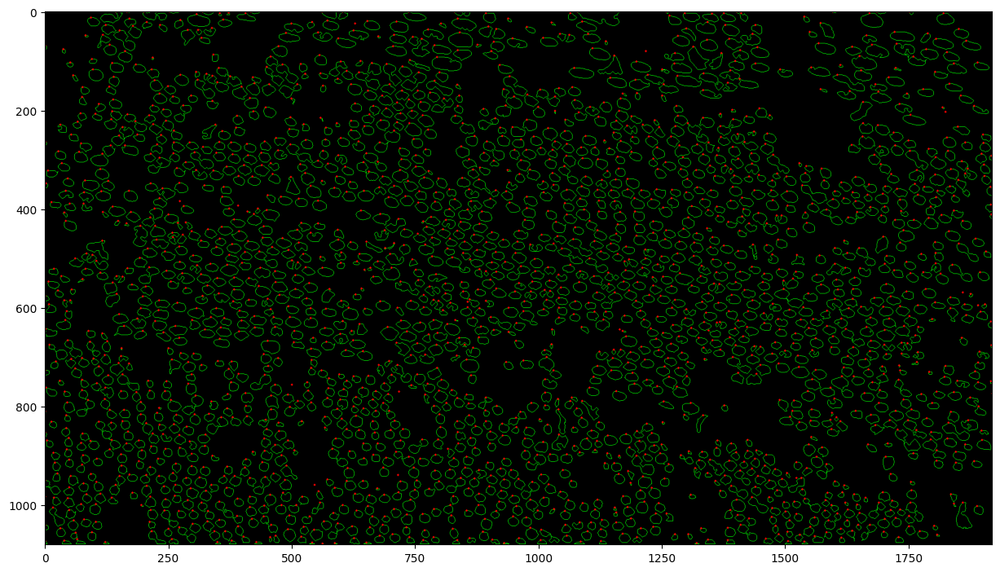

In [41]:
first_element_of_contours_2 = np.array([np.uint32(contours_fibers_filtered[i][0][0]) for i in range(len(contours_fibers_filtered))])
img_points_2 = img_contornos_3.copy()

for p in first_element_of_contours_2:
    cv2.circle(img_points_2, (p[0],p[1]), 2, (255,0,0), -1)


fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1, 1, 1)
ax.imshow(img_points_2,vmin=0,vmax=255)
plt.show()

[(1078, 562), (1077, 1320)]


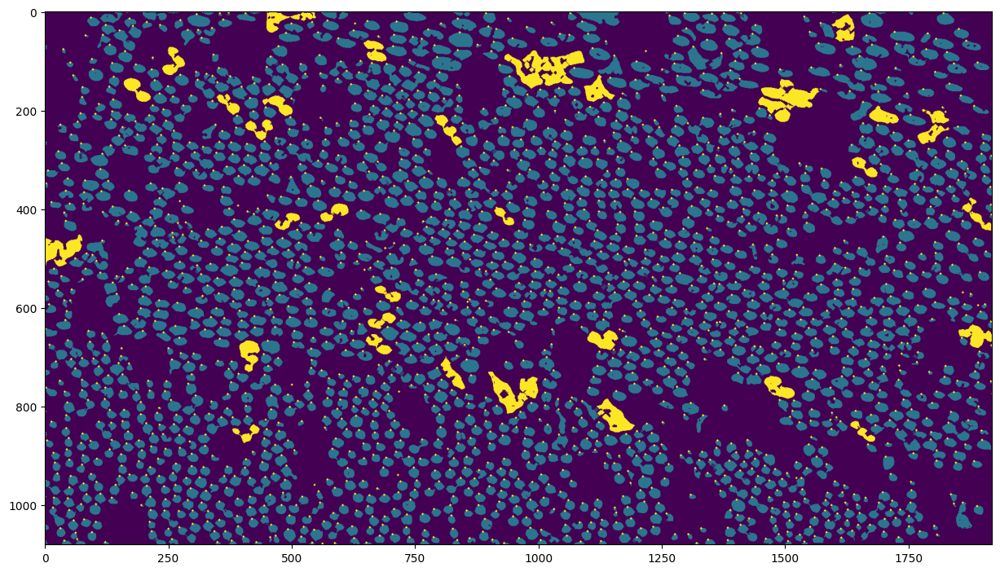

In [42]:
list_coordinates_2 = [(np.uint16(p[1]),np.uint16(p[0])) for p in first_element_of_contours_2]
print(list_coordinates_2[0:2])

test_9 = test_4.copy()
test_9[test_9 != 0] = 255

list_masks_2 = []

for coordinate in list_coordinates_2:
    mask = ski.segmentation.flood(test_9, coordinate, tolerance=1)
    list_masks_2.append(mask)
    test_9[mask] = 100

for p in first_element_of_contours_2:
    cv2.circle(test_9, (p[0],p[1]), 2, (255,0,0), -1)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1, 1, 1)
ax.imshow(test_9,vmin=0,vmax=255)
plt.show()

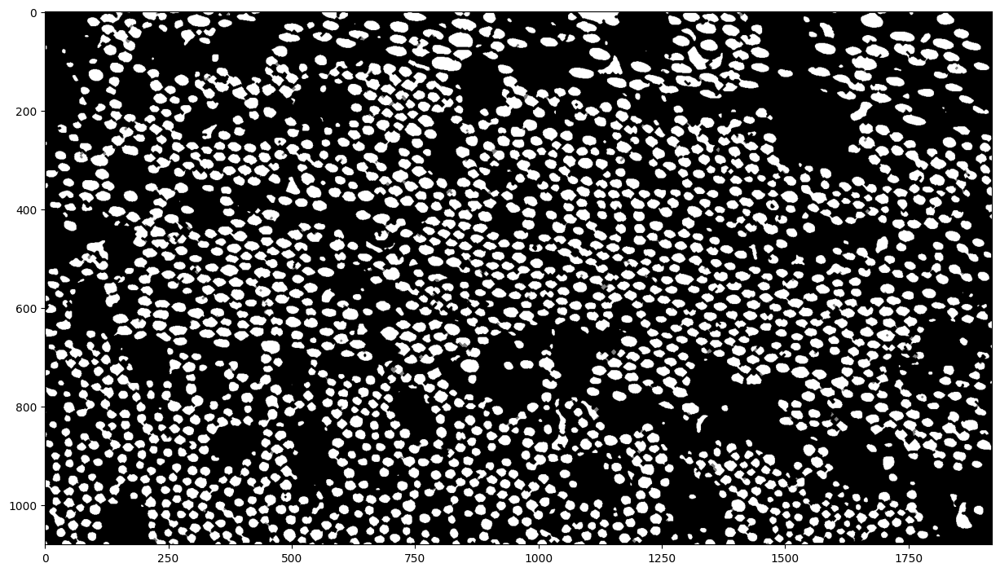

In [43]:
mask_fibers = np.zeros(np.shape(test_4),dtype=np.uint8)
for mask in list_masks_2:
    mask_fibers[mask] = 255

kernel_cl = np.array([[0, 1, 0],
                   [1, 0, 1],
                   [0, 1, 0]], dtype=np.uint8)
mask_fibers = cv2.morphologyEx(mask_fibers, cv2.MORPH_CLOSE, kernel_cl,iterations=2)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1, 1, 1)
ax.imshow(mask_fibers,cmap='gray',vmin=0,vmax=255)
plt.show()

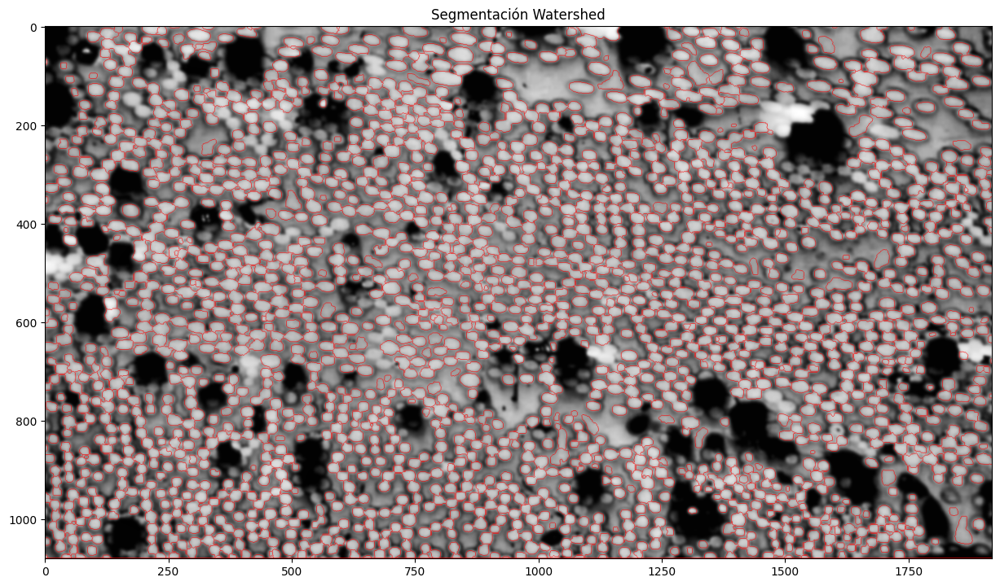

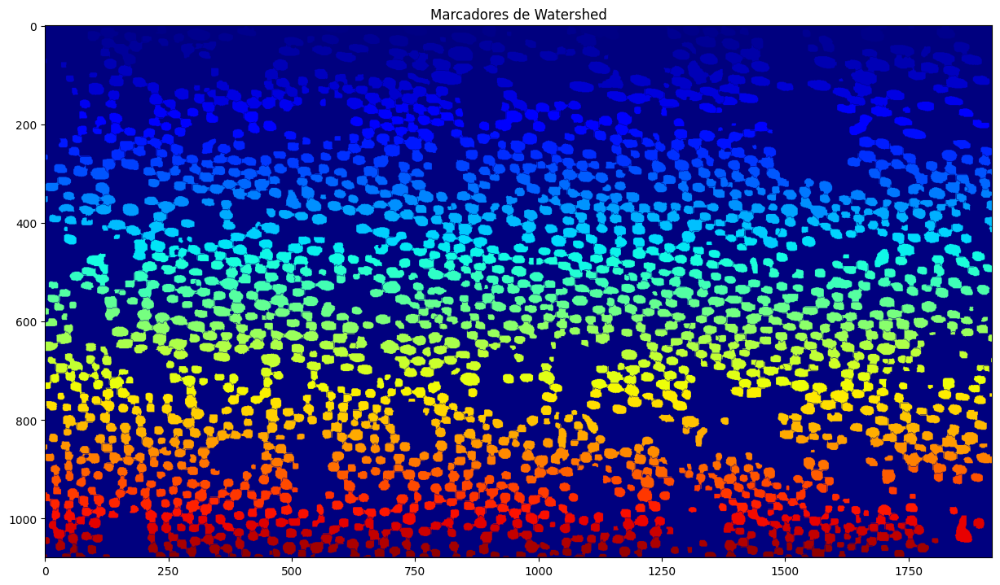

In [44]:
# 1. Define kernels adecuados para cada operación
kernel_op = np.ones((3,3), np.uint8)  # Para opening
kernel_dil = np.ones((3,3), np.uint8)  # Para dilatación

# 2. Preprocesamiento mejorado
opening = cv2.morphologyEx(mask_fibers, cv2.MORPH_OPEN, kernel_op, iterations=2)

# 3. Área de fondo seguro con kernel correcto
sure_bg = cv2.dilate(opening, kernel_dil, iterations=3)

# 4. Área de primer plano seguro - ajusta el factor de threshold si es necesario
dist_transform = cv2.distanceTransform(opening, cv2.DIST_C, 5)
# Prueba con diferentes valores: 0.5, 0.6, 0.7, 0.8
threshold_factor = 0.025
ret, sure_fg = cv2.threshold(dist_transform, threshold_factor*dist_transform.max(), 255, 0)

# 5. Región desconocida
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg, sure_fg)

# 6. Etiquetado de marcadores
ret, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown==255] = 0

# 7. Aplicar watershed
img_rgb = cv2.cvtColor(test_2, cv2.COLOR_GRAY2RGB)
markers = cv2.watershed(img_rgb, markers)

# 8. Visualizar resultados mejorados
# Resultado de watershed
result_img = img_rgb.copy()
result_img[markers == -1] = [255, 0, 0]  # Boundaries en rojo
plt.figure(figsize=(15,15))
plt.imshow(result_img)
plt.title('Segmentación Watershed')
plt.show()

# Para visualizar mejor los marcadores
plt.figure(figsize=(15,15))
plt.imshow(markers, cmap='jet')  # El mapa jet muestra mejor las diferentes regiones
plt.title('Marcadores de Watershed')
plt.show()

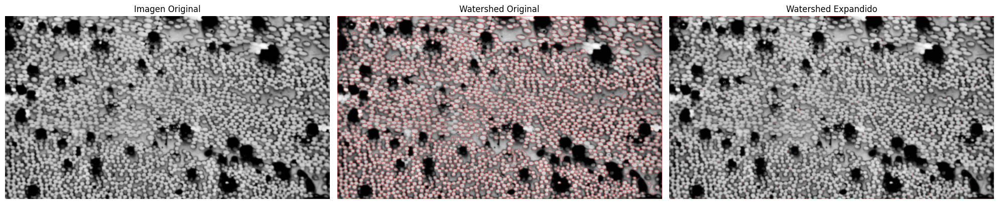

In [45]:
# Utiliza los resultados de watershed como punto de partida
regions_result = markers.copy()
img_gray = test_2.copy()  # La imagen en escala de grises original

# Crear una máscara expandida
expanded_mask = np.zeros_like(img_gray, dtype=np.uint8)

# Primero, identifica las regiones que ya fueron segmentadas (excluyendo bordes y fondo)
valid_labels = np.unique(regions_result)
valid_labels = valid_labels[valid_labels > 1]  # Ignorar fondo (0,1) y bordes (-1)

# Para cada región segmentada por watershed, expande a píxeles adyacentes con intensidad similar
for label in valid_labels:
    # Máscara de la región actual
    region_mask = (regions_result == label)
    
    # Calcular estadísticas de intensidad de esta región
    region_intensities = img_gray[region_mask]
    mean_intensity = np.mean(region_intensities)
    std_intensity = np.std(region_intensities)
    
    # Dilatar la región para encontrar píxeles vecinos
    kernel = np.ones((3,3), np.uint8)
    dilated = cv2.dilate(region_mask.astype(np.uint8), kernel, iterations=2)
    
    # Encontrar píxeles vecinos (dilatados - originales)
    neighbors = dilated & ~region_mask
    
    # Para los vecinos, verificar si su intensidad es similar a la región
    for y, x in zip(*np.where(neighbors)):
        if abs(int(img_gray[y, x]) - mean_intensity) < 15 * std_intensity:
            # Si el píxel tiene intensidad similar, asígnalo a esta región
            regions_result[y, x] = label
            
    # Añadir esta región al resultado expandido
    expanded_mask[regions_result == label] = 255

# Visualizar resultados
fig, axes = plt.subplots(1, 3, figsize=(20, 10))

# Imagen original
axes[0].imshow(test_2, cmap='gray')
axes[0].set_title('Imagen Original')
axes[0].axis('off')

# Segmentación watershed original
result_img_original = img_rgb.copy()
result_img_original[markers == -1] = [255, 0, 0]
axes[1].imshow(result_img_original)
axes[1].set_title('Watershed Original')
axes[1].axis('off')

# Segmentación expandida
result_img_expanded = img_rgb.copy()
result_img_expanded[regions_result == -1] = [255, 0, 0]  # Boundaries en rojo
axes[2].imshow(result_img_expanded)
axes[2].set_title('Watershed Expandido')
axes[2].axis('off')

plt.tight_layout()
plt.show()

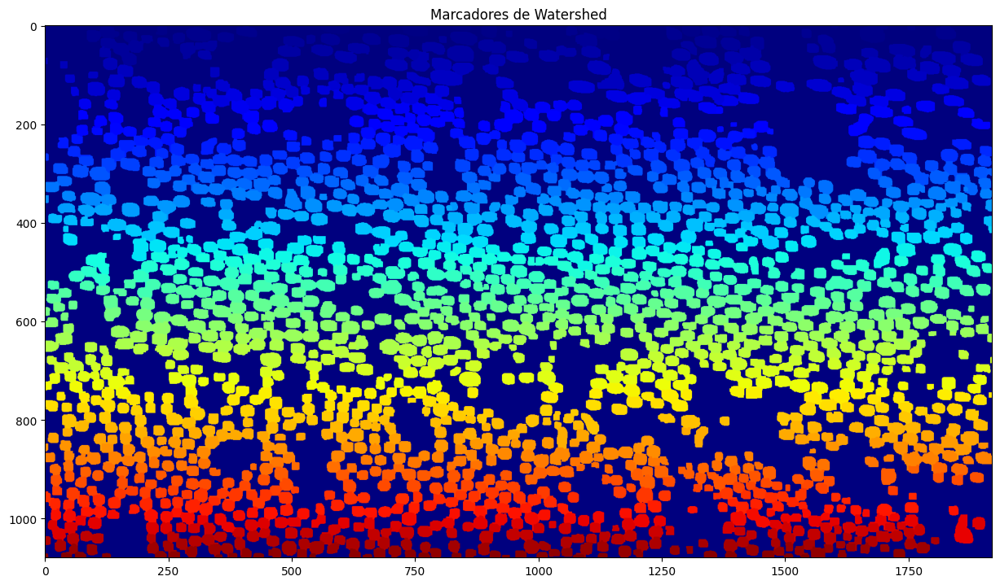

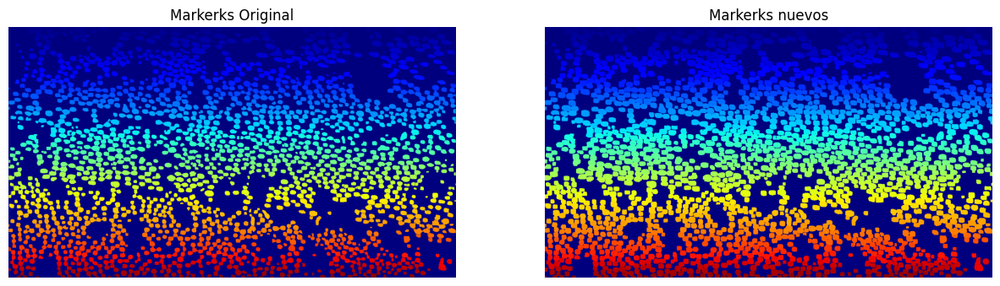

In [46]:
# Para visualizar mejor los marcadores
plt.figure(figsize=(15,15))
plt.imshow(regions_result, cmap='jet')  # El mapa jet muestra mejor las diferentes regiones
plt.title('Marcadores de Watershed')
plt.show()

fig = plt.figure(figsize=(15,15))

ax = plt.subplot(1, 2, 1)
ax.imshow(markers, cmap='jet')
ax.set_title('Markerks Original')
ax.axis('off')

ax = plt.subplot(1, 2, 2)
ax.imshow(regions_result, cmap='jet')
ax.set_title('Markerks nuevos')
ax.axis('off')

plt.show()

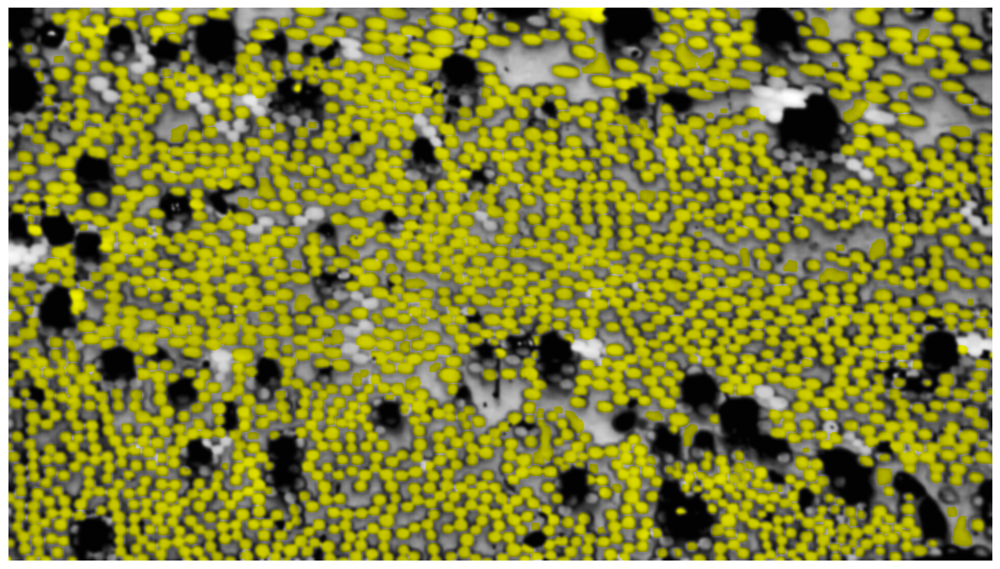

In [47]:
binary_mask = np.zeros_like(regions_result, dtype=np.uint8)
binary_mask[regions_result > 1] = 255  # Set foreground regions to 255 (white)

# Aplicar la máscara binaria a la imagen original
test_2_rgb_masked = cv2.cvtColor(test_2, cv2.COLOR_GRAY2RGB)
test_2_rgb_masked[binary_mask != 0] = test_2_rgb_masked[binary_mask != 0]*[1, 1, 0]  # Set background regions to black
fig = plt.figure(figsize=(15, 15))
plt.imshow(test_2_rgb_masked, cmap='gray')
plt.axis('off')
plt.show()

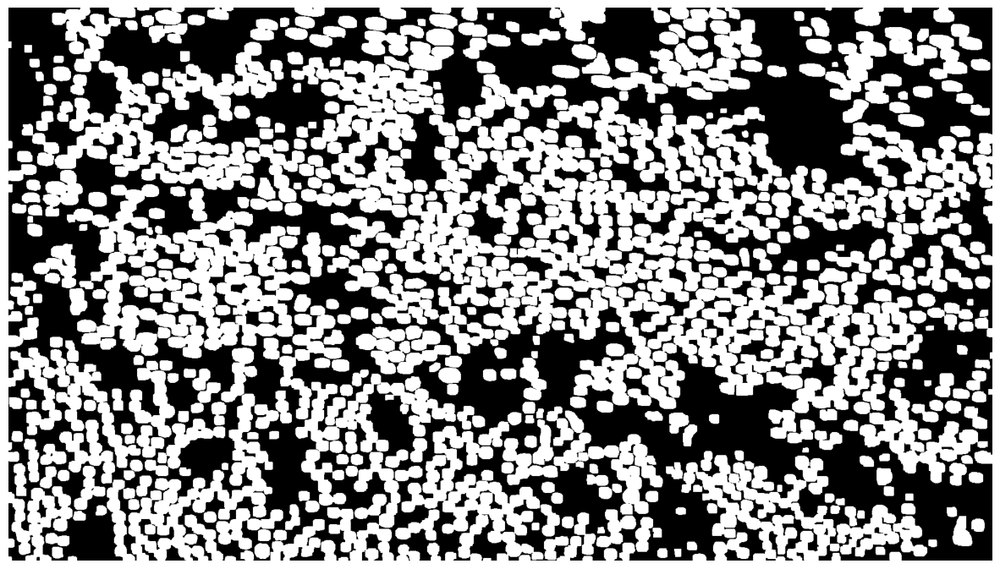

In [48]:
# Visualizar resultados
plt.figure(figsize=(15,15))
plt.imshow(binary_mask, cmap='gray')
plt.axis('off')
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Number of contours: 445


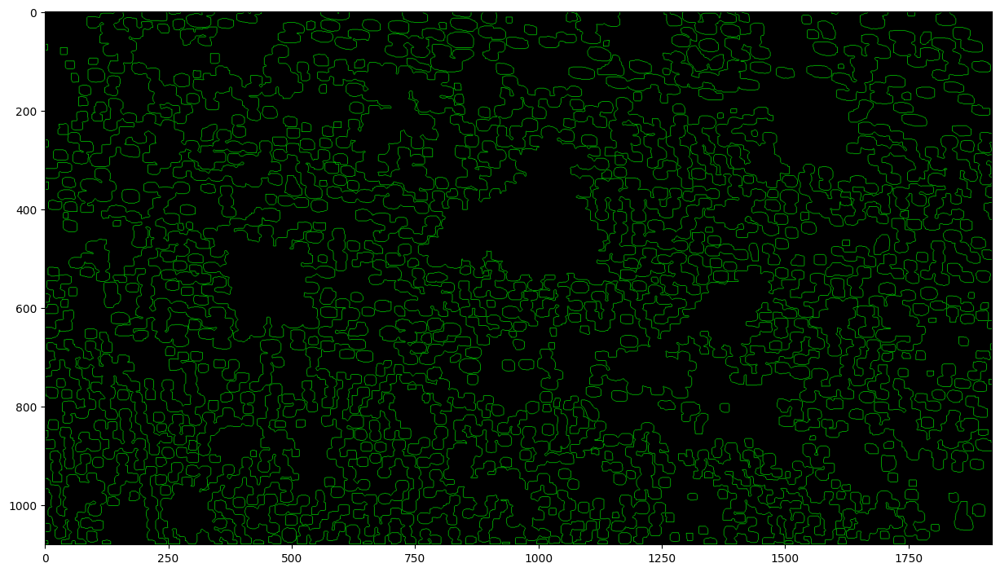

81.4808988764045
271.76183842872115


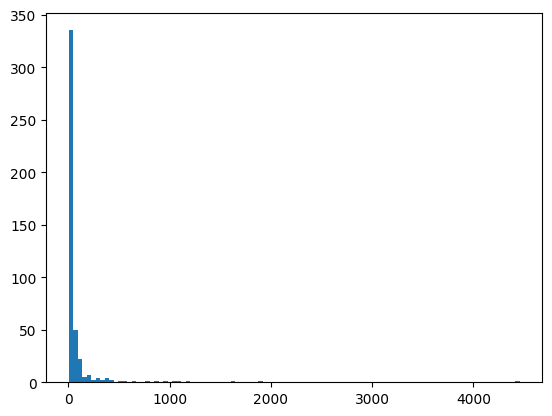

445


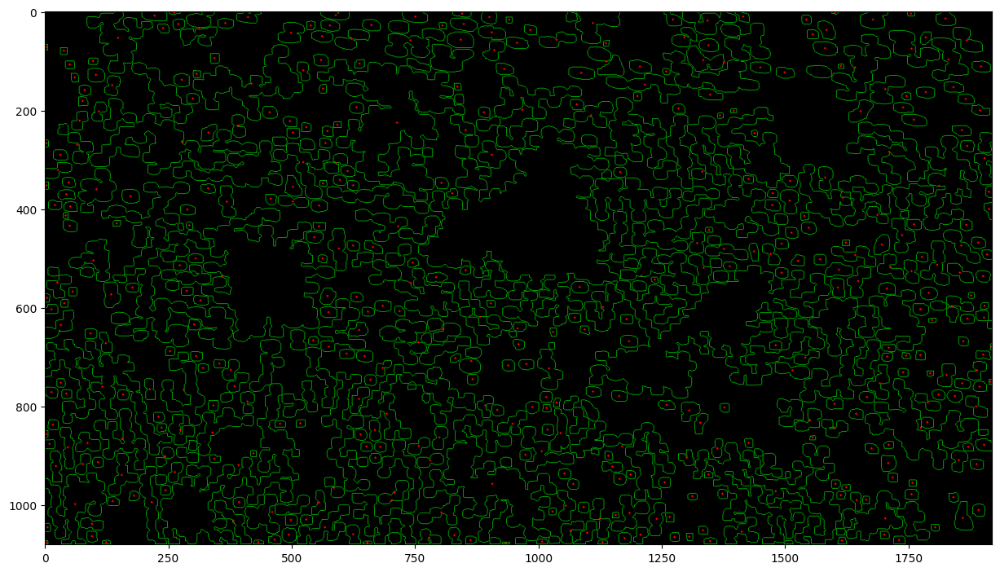

In [49]:
def contornos(binary_mask):

    contours_wsmask, _ = cv2.findContours(image=binary_mask, mode=cv2.RETR_EXTERNAL, method=cv2.CHAIN_APPROX_SIMPLE)

    print(f"Number of contours: {len(contours_wsmask)}")

    dim = np.shape(test_5)

    img_contornos_2 = cv2.drawContours(np.zeros((dim[0],dim[1],3)), contours_wsmask, -1, (0,255,0), 1)
    img_contornos_3 = np.uint8(img_contornos_2)

    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(img_contornos_2,vmin=0,vmax=255)
    plt.show()

    contours_wsmask_lenght = [len(c) for c in contours_wsmask]

    cfl_mean = np.mean(contours_wsmask_lenght)
    cfl_std = np.std(contours_wsmask_lenght)

    print(cfl_mean)
    print(cfl_std)

    plt.hist(contours_wsmask_lenght, bins=100)
    plt.show()

    img_points_2 = img_contornos_3.copy()

    centroids = []
    for c in contours_wsmask:
       # calculate moments for each contour
       M = cv2.moments(c)
    
       # calculate x,y coordinate of center
       cX = int(M["m10"] / M["m00"])
       cY = int(M["m01"] / M["m00"])
       #cv2.circle(img_points_2, (cX,cY), 3, (255,0,0), -1)
       centroids.append((cY,cX))

    print(len(centroids))

    for p in centroids:
        cv2.circle(img_points_2, (p[1],p[0]), 2, (255,0,0), -1)


    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(img_points_2,vmin=0,vmax=255)
    plt.show()

    return centroids

centroids = contornos(binary_mask)

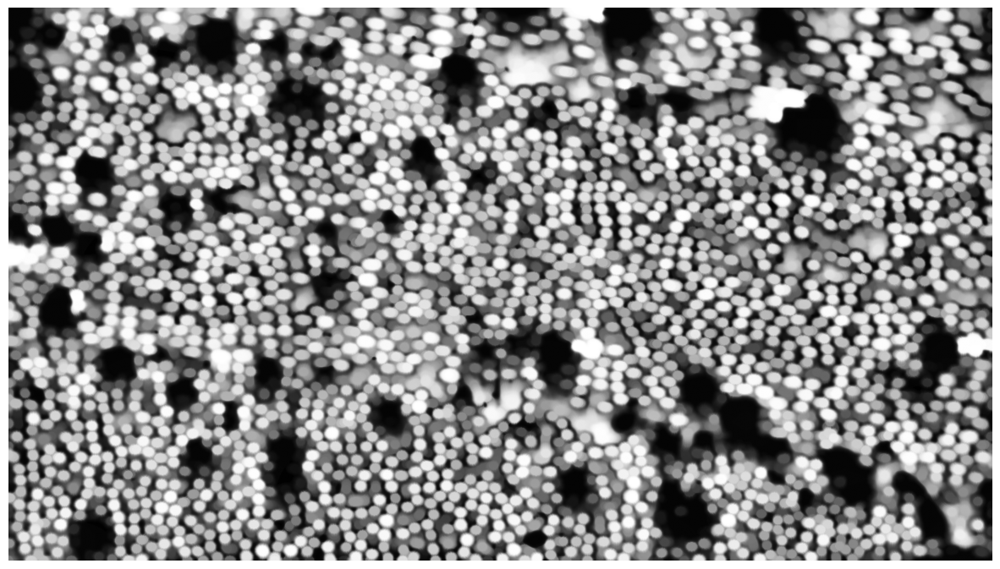

(-0.5, 1919.5, 1079.5, -0.5)

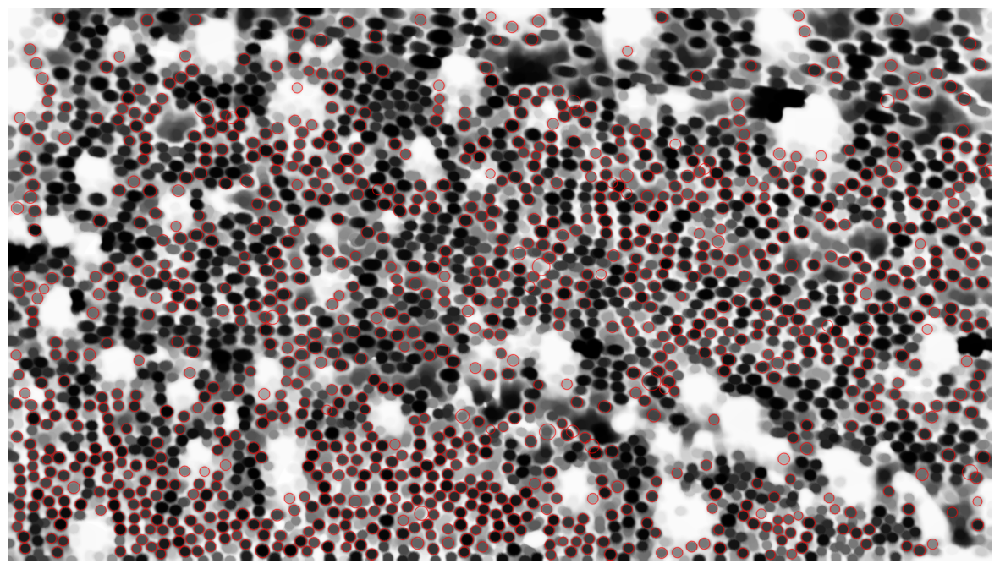

In [50]:
test_10 = test_2.copy()

kernel_test = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (17,17)) #(17,17)
test_10 = cv2.morphologyEx(test_10, cv2.MORPH_OPEN, kernel_test,iterations=1)
test_10 = cv2.equalizeHist(test_10)
test_10 = clahe.apply(test_10)


fig = plt.figure(figsize=(15,15))
plt.imshow(test_10,cmap='gray',vmin=0,vmax=255)
plt.axis('off')
plt.show()                 

test_11 = test_10.copy()
test_11 = cv2.bitwise_not(test_11)

"""test_11 = cv2.adaptiveThreshold(test_11, 255,
	cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 21, 4)
"""

test_11 = cv2.cvtColor(test_11, cv2.COLOR_GRAY2RGB)


# Set our filtering parameters 
# Initialize parameter setting using cv2.SimpleBlobDetector 
params = cv2.SimpleBlobDetector_Params() 

# Set Area filtering parameters 
params.filterByArea = True
params.minArea = 50
params.maxArea = 500

# Set Circularity filtering parameters 
params.filterByCircularity = True
params.minCircularity = 0.00001

# Set Convexity filtering parameters 
params.filterByConvexity = True
params.minConvexity = 0.00001
	
# Set inertia filtering parameters 
params.filterByInertia = True
params.minInertiaRatio = 0.00001

# Create a detector with the parameters 
detector = cv2.SimpleBlobDetector_create(params) 
	
# Detect blobs 
keypoints = detector.detect(test_11) 

# Draw blobs on our image as red circles 
blank = np.zeros((1, 1)) 
blobs = cv2.drawKeypoints(test_11, keypoints, blank, (255, 0, 0), 
						cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 

fig = plt.figure(figsize=(15,15))
plt.imshow(blobs,vmin=0,vmax=255)
plt.axis('off')

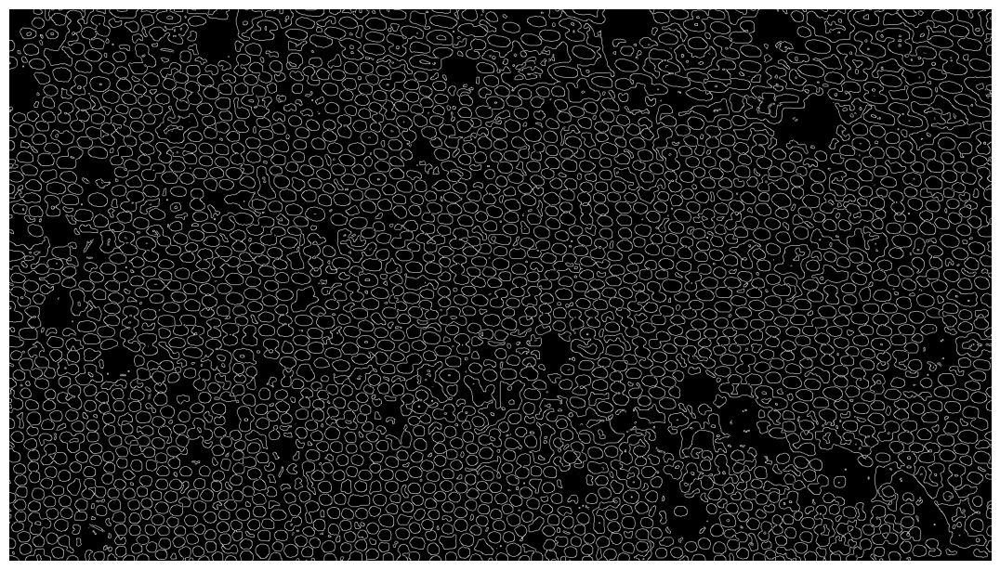

In [51]:
thresh_2 = cv2.adaptiveThreshold(cv2.GaussianBlur(test_10,(7,7),0), 255,
	cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 21, 0.5)

# Crear kernel para operación morfológica
kernel_bh = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))

# Aplicar transformación Black Hat
black_hat = cv2.morphologyEx(cv2.bitwise_not(thresh_2), cv2.MORPH_BLACKHAT, kernel_bh)

borders = cv2.Canny(cv2.absdiff(thresh_2,50*black_hat), 100, 200)

fig = plt.figure(figsize=(30,30))
ax = plt.subplot(1, 2, 1)
ax.imshow(borders,cmap='gray',vmin=0,vmax=255)
ax.axis('off')
plt.show()


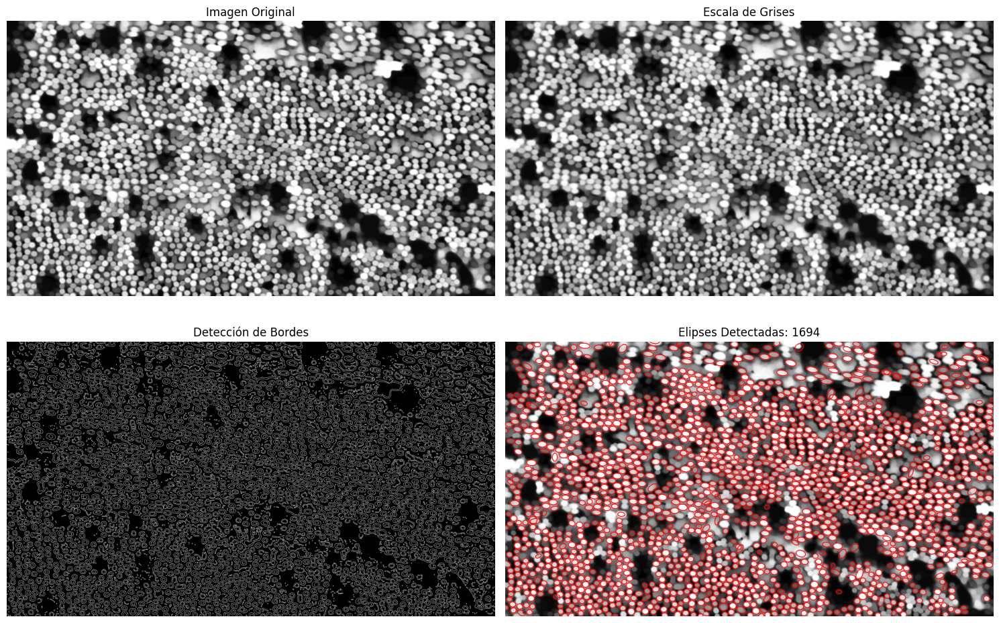

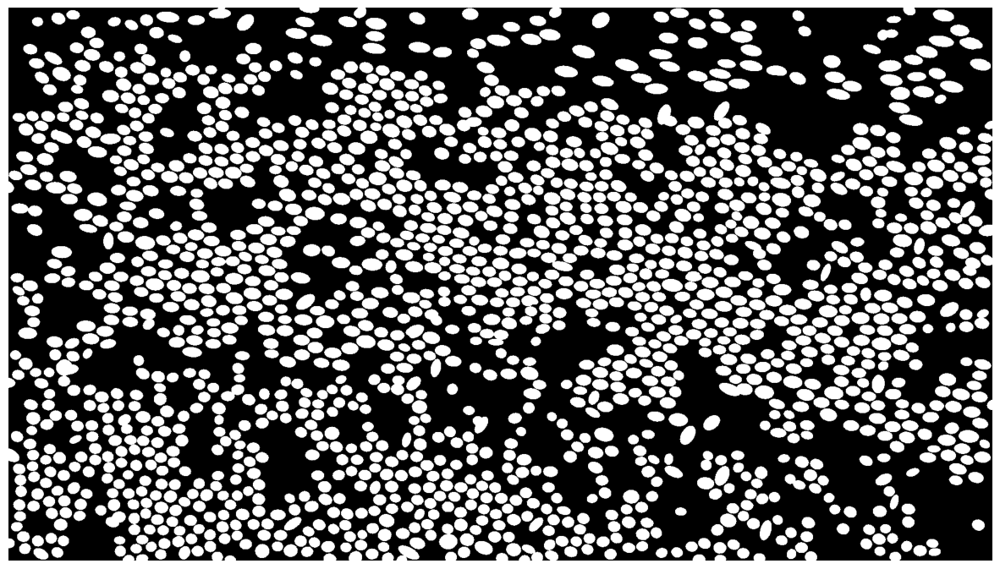

In [52]:
def detectar_elipses(imagen, mostrar_resultados=True):
    # Cargar la imagen
    imagen_original = imagen.copy()
    
    # Convertir a escala de grises
    #gris = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
    gris = imagen

    # Aplicar desenfoque gaussiano para reducir ruido
    gris = cv2.GaussianBlur(gris, (7, 7), 0)

    """# Detección de bordes con Canny
    bordes = cv2.Canny(gris, 50, 200)

    # Dilatación para cerrar posibles brechas en los bordes
    kernel = np.ones((3, 3), np.uint8)
    bordes = cv2.dilate(bordes, kernel, iterations=1)"""
    
    thresh_2 = cv2.adaptiveThreshold(gris, 255,
	cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 3, 0.5)

    # Crear kernel para operación morfológica
    kernel_bh = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    # Aplicar transformación Black Hat
    black_hat = cv2.morphologyEx(cv2.bitwise_not(thresh_2), cv2.MORPH_BLACKHAT, kernel_bh)

    bordes = cv2.Canny(cv2.absdiff(thresh_2,50*black_hat), 100, 200)

    #bordes = cv2.Canny(thresh_2, 50, 50)

    # Encontrar contornos
    contornos, _ = cv2.findContours(bordes, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    

    imagen_rgb = cv2.cvtColor(imagen, cv2.COLOR_GRAY2RGB)

    # Lista para almacenar elipses detectadas
    elipses = []
    mascara_elipses = np.zeros_like(imagen, dtype=np.uint8)  # Máscara para elipses

    # Ajustar elipses a los contornos
    for contorno in contornos:
        # Ignorar contornos muy pequeños
        if len(contorno) >= 5:  # Necesitamos al menos 5 puntos para ajustar una elipse
            elipse = cv2.fitEllipse(contorno)
            
            # Filtrar por tamaño o relación de aspecto si es necesario
            (x, y), (MA, ma), angle = elipse
            
            # Calcular características para filtrado
            area = MA * ma * np.pi / 4
            relacion_aspecto = ma / MA if MA > 0 else 0  # Radio menor / Radio mayor
            angulo = angle % 180

            # Ejemplo de filtro: solo elipses con área mayor a un umbral
            if (area > 250 and area < 800) and (relacion_aspecto < 2.5) and (angulo > 0 and angulo < 120):  
                elipses.append(elipse)
                # Dibujar la elipse en la imagen original
                cv2.ellipse(imagen_rgb, elipse, (255, 0, 0), 2)

                # Dibujar la elipse rellena en la máscara binaria
                cv2.ellipse(mascara_elipses, elipse, 255, -1)  # -1 indica relleno completo
    
    if mostrar_resultados:
        # Mostrar los resultados
        plt.figure(figsize=(15, 10))
        
        plt.subplot(2, 2, 1)
        plt.imshow(cv2.cvtColor(imagen_original, cv2.COLOR_BGR2RGB))
        plt.title('Imagen Original')
        plt.axis('off')
        
        plt.subplot(2, 2, 2)
        plt.imshow(gris, cmap='gray')
        plt.title('Escala de Grises')
        plt.axis('off')
        
        plt.subplot(2, 2, 3)
        plt.imshow(bordes, cmap='gray')
        plt.title('Detección de Bordes')
        plt.axis('off')
        
        plt.subplot(2, 2, 4)
        plt.imshow(imagen_rgb)
        plt.title(f'Elipses Detectadas: {len(elipses)}')
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()
    
    return elipses, mascara_elipses

test_12 = test_10.copy()
test_12 = cv2.equalizeHist(test_12)

epilses, mascara_elipses = detectar_elipses(test_12, mostrar_resultados=True)

fig = plt.figure(figsize=(15,15))
plt.imshow(mascara_elipses,cmap='gray')
plt.axis('off')
plt.show()

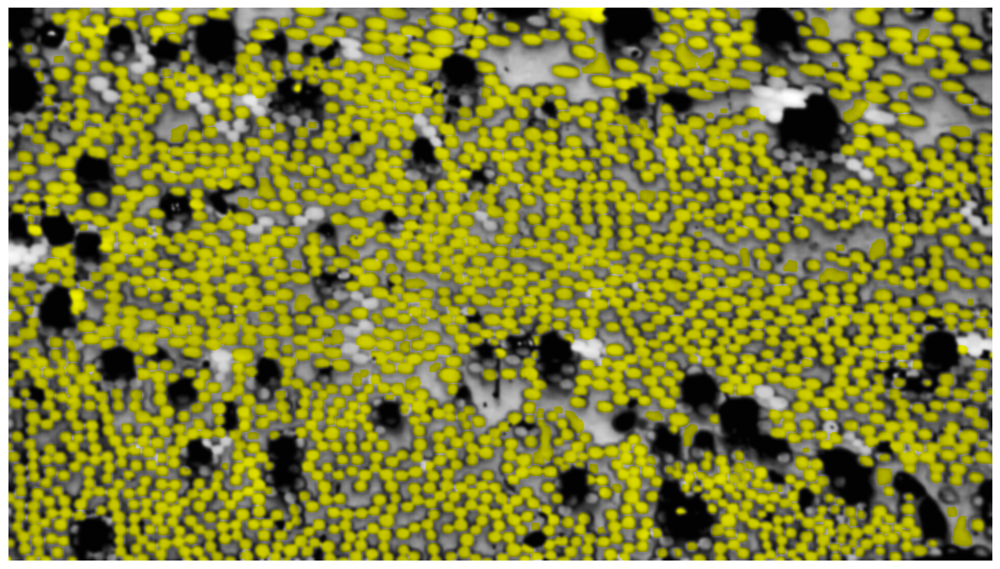

In [58]:
import getmefibers as gmf

binary_mask_test, _, _ = gmf.getMeFibers(img_selected)

img_selected_rgb = cv2.cvtColor(test_2, cv2.COLOR_GRAY2RGB)
img_selected_rgb[binary_mask_test != 0] = img_selected_rgb[binary_mask_test != 0]*[1, 1, 0]  # Set background regions to black

fig = plt.figure(figsize=(15, 15))
plt.imshow(img_selected_rgb, vmin=0, vmax=255)
plt.axis('off')
plt.show()


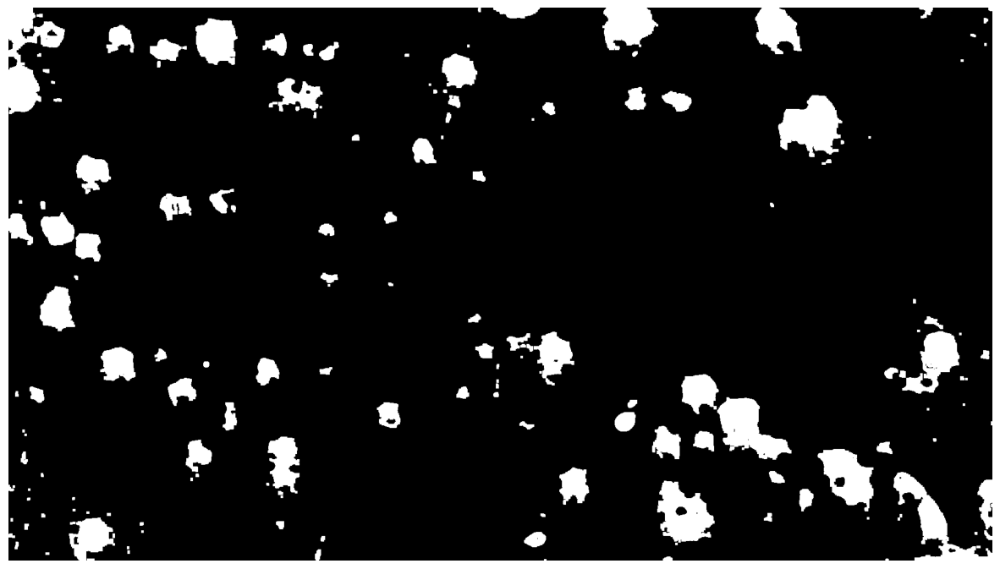

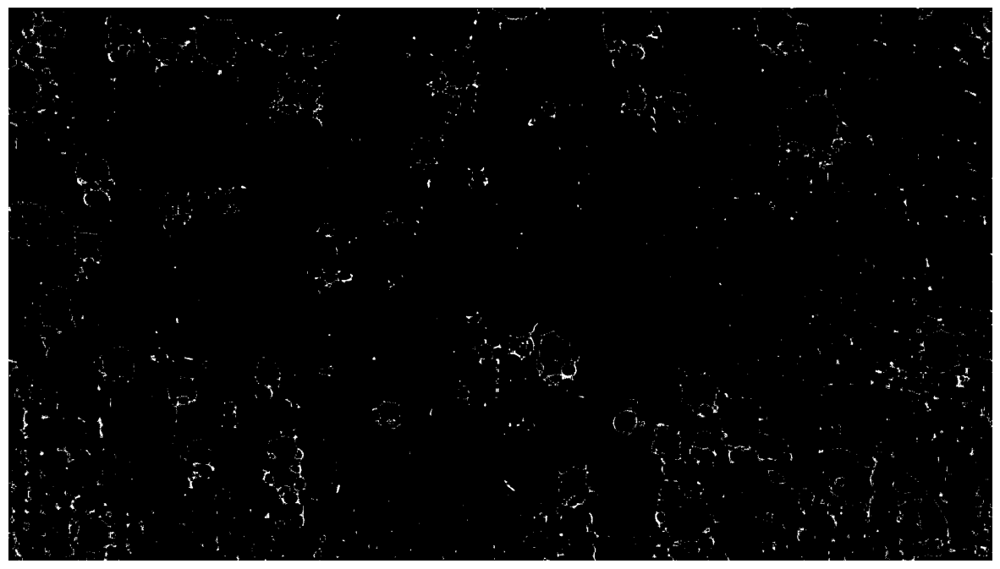

In [64]:
import getmepores as gmp

mask_bubbles, undefined_region_mask = gmp.getMetPores(img_selected)

fig = plt.figure(figsize=(15, 15))
plt.imshow(mask_bubbles, cmap='gray')
plt.axis('off')
plt.show()

fig = plt.figure(figsize=(15, 15))
plt.imshow(undefined_region_mask, cmap='gray')
plt.axis('off')
plt.show()

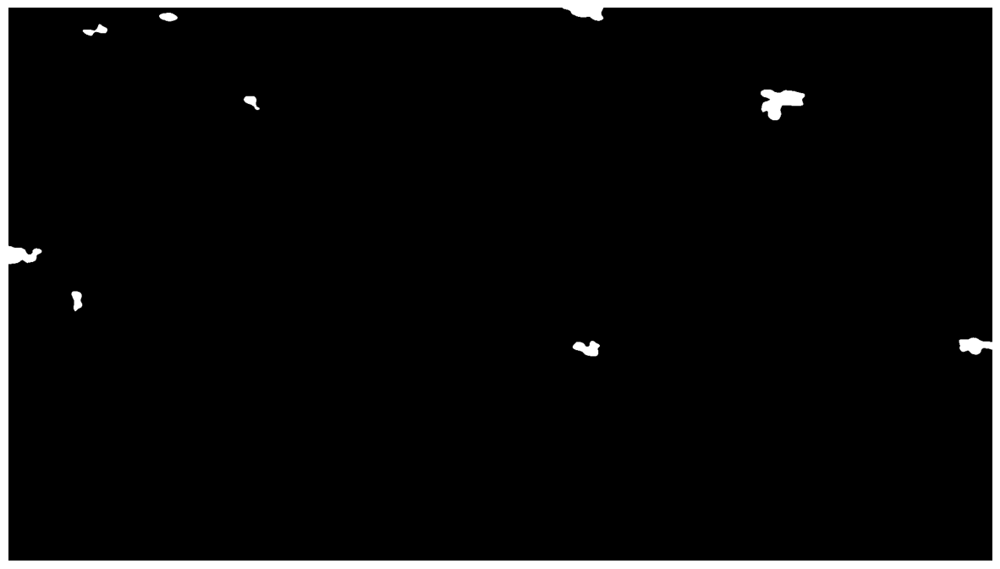

In [66]:
import getmeflashes as gmfl

mask_flashes = gmfl.getMeFlashes(img_selected,cont_mult=1.5)

fig = plt.figure(figsize=(15, 15))
plt.imshow(mask_flashes, cmap='gray',vmin=0,vmax=255)
plt.axis('off')
plt.show()